<a href="https://colab.research.google.com/github/Adarshthakur-850/Smartan_Project/blob/main/Smartan__Project.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# ***Real-Time Fitness Posture Evaluation Using MediaPipe Pose***

# *Install Required Libraries*

In [ ]:
!pip install mediapipe opencv-python

In [ ]:
!pip install mediapipe opencv-python numpy



In [ ]:
!pip install pypdf

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 328.3/328.3 kB 6.4 MB/s eta 0:00:00


In [ ]:
import cv2
import mediapipe as mp
import numpy as np
from google.colab import files
from google.colab.patches import cv2_imshow


/usr/local/lib/python3.12/dist-packages/jaxlib/plugin_support.py:71: RuntimeWarning: JAX plugin jax_cuda12_plugin version 0.7.2 is installed, but it is not compatible with the installed jaxlib version 0.7.1, so it will not be used.
  warnings.warn(


In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [ ]:
uploaded = files.upload()
input_video_path = list(uploaded.keys())[0]
print("Uploaded:", input_video_path)


Saving Screen Recording 2025-12-10 224759.mp4 to Screen Recording 2025-12-10 224759.mp4
Uploaded: Screen Recording 2025-12-10 224759.mp4


In [ ]:
mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose
pose = mp_pose.Pose(static_image_mode=False,
                    model_complexity=1,
                    enable_segmentation=False,
                    min_detection_confidence=0.5,
                    min_tracking_confidence=0.5)
print("All necessary libraries imported and MediaPipe Pose initialized.")


All necessary libraries imported and MediaPipe Pose initialized.


*Frame works*

In [ ]:
from google.colab.patches import cv2_imshow

uploaded = files.upload()
input_video_path = list(uploaded.keys())[0]
print("Uploaded:", input_video_path)

cap = cv2.VideoCapture(input_video_path)

while cap.isOpened():
    success, frame = cap.read()
    if not success:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb_frame)

    if results.pose_landmarks:
        mp_drawing.draw_landmarks(frame,
                                  results.pose_landmarks,
                                  mp_pose.POSE_CONNECTIONS)

    cv2_imshow(frame)

    if cv2.waitKey(10) & 0xFF == ord('q'):
        break

cap.release()

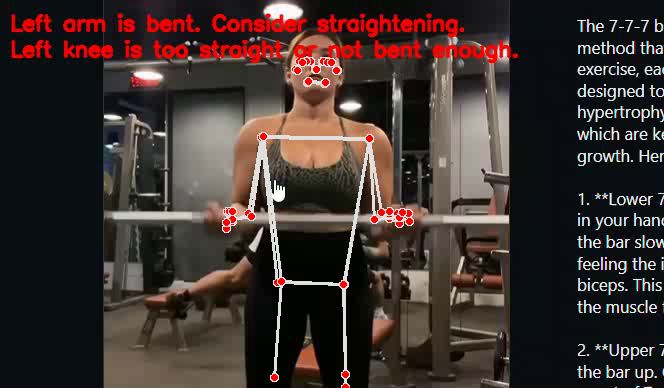

In [ ]:
cap = cv2.VideoCapture(input_video_path)

from google.colab.patches import cv2_imshow

success, frame = cap.read()
rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
results = pose.process(rgb_frame)

if results.pose_landmarks:
    mp_drawing.draw_landmarks(frame,
                              results.pose_landmarks,
                              mp_pose.POSE_CONNECTIONS)

cv2_imshow(frame)
cap.release()



In [ ]:
pose_data = []

cap = cv2.VideoCapture(input_video_path)

original_fps = cap.get(cv2.CAP_PROP_FPS)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

print(f"Processing video: {input_video_path}")
print(f"Original FPS: {original_fps}, Width: {frame_width}, Height: {frame_height}")

frame_count = 0
while cap.isOpened():
    success, frame = cap.read()
    if not success:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb_frame)

    if results.pose_landmarks:
        keypoints = []
        for lm in results.pose_landmarks.landmark:
            keypoints.append([lm.x, lm.y, lm.visibility])
        pose_data.append(keypoints)
    else:
        pose_data.append([[np.nan, np.nan, np.nan]] * mp_pose.PoseLandmark.COUNT)
    frame_count += 1

cap.release()

pose_array = np.array(pose_data)
print(f"Finished processing {frame_count} frames.")
print("Shape of keypoint array:", pose_array.shape)

Processing video: Screen Recording 2025-12-10 224759 (1).mp4
Original FPS: 30.0, Width: 664, Height: 388
Finished processing 562 frames.
Shape of keypoint array: (562, 33, 3)


Pose Detection System

In [ ]:
import cv2
import mediapipe as mp
import numpy as np

mp_drawing = mp.solutions.drawing_utils
mp_pose = mp.solutions.pose
pose = mp_pose.Pose(static_image_mode=False,
                    model_complexity=1,
                    min_detection_confidence=0.5,
                    min_tracking_confidence=0.5)


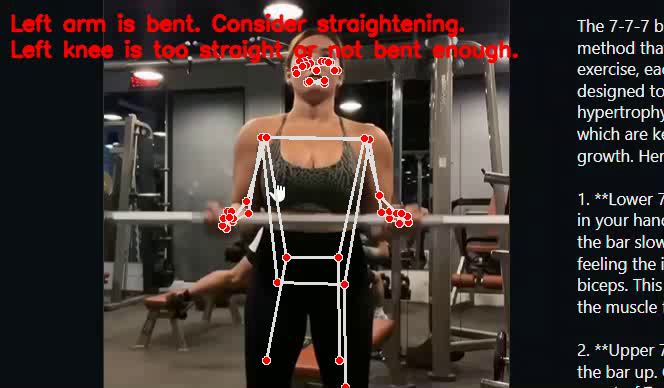

In [ ]:
cap = cv2.VideoCapture(input_video_path)

pose_data = []
while cap.isOpened():
    success, frame = cap.read()
    if not success:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb_frame)

    if results.pose_landmarks:
        landmarks = results.pose_landmarks.landmark

        keypoints = []
        for lm in landmarks:
            keypoints.append([lm.x, lm.y, lm.visibility])

        pose_data.append(keypoints)

        mp_drawing.draw_landmarks(frame,
                                  results.pose_landmarks,
                                  mp_pose.POSE_CONNECTIONS)

    from google.colab.patches import cv2_imshow
    cv2_imshow(frame)
    break
cap.release()


In [ ]:
pose_array = np.array(pose_data)
print("Shape of keypoint array:", pose_array.shape)


Shape of keypoint array: (1, 33, 3)


In [ ]:
def moving_average(data, k=3):
    if data.shape[0] < k:
        return data
    return np.convolve(data, np.ones(k)/k, mode='same')

for i in range(pose_array.shape[1]):
    for j in range(2):
        pose_array[:, i, j] = moving_average(pose_array[:, i, j])

Main Code

In [ ]:
cap = cv2.VideoCapture(input_video_path)

pose_data = []
while cap.isOpened():
    success, frame = cap.read()
    if not success:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb_frame)

    if results.pose_landmarks:
        landmarks = results.pose_landmarks.landmark

        keypoints = []
        for lm in landmarks:
            keypoints.append([lm.x, lm.y, lm.visibility])

        pose_data.append(keypoints)

        mp_drawing.draw_landmarks(frame,
                                  results.pose_landmarks,
                                  mp_pose.POSE_CONNECTIONS)

    from google.colab.patches import cv2_imshow
    cv2_imshow(frame)

cap.release()

## *Distribution of Left Elbow and Knee Angles*

NameError: name 'posture_df' is not defined

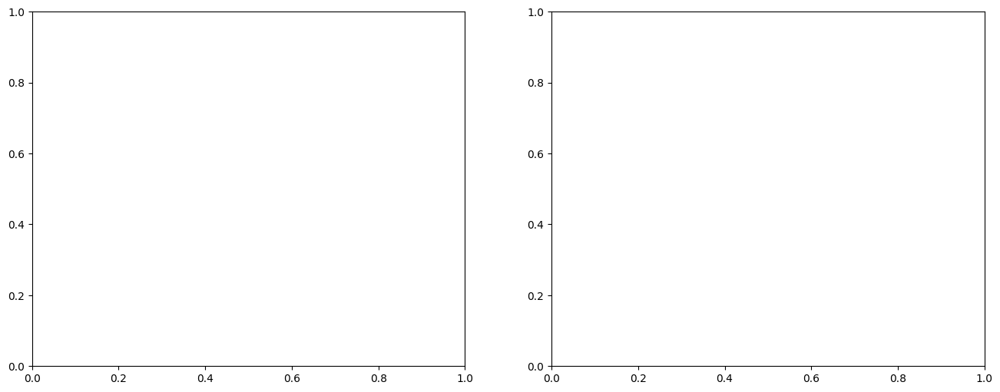

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

fig, axes = plt.subplots(1, 2, figsize=(16, 6))

sns.histplot(posture_df['left_elbow_angle'].dropna(), bins=20, kde=True, ax=axes[0])
axes[0].set_title('Distribution of Left Elbow Angle')
axes[0].set_xlabel('Angle (degrees)')
axes[0].set_ylabel('Frequency')

sns.histplot(posture_df['left_knee_angle'].dropna(), bins=20, kde=True, ax=axes[1])
axes[1].set_title('Distribution of Left Knee Angle')
axes[1].set_xlabel('Angle (degrees)')
axes[1].set_ylabel('Frequency')

plt.tight_layout()
plt.show()

In [ ]:
import math
import pandas as pd

def calculate_angle(a, b, c):
    """
    Calculates the angle in degrees between three 2D points (A, B, C),
    where B is the vertex of the angle.
    Handles NaN values gracefully.
    """
    if np.isnan(a).any() or np.isnan(b).any() or np.isnan(c).any():
        return np.nan

    a = np.array(a)
    b = np.array(b)
    c = np.array(c)

    radians = np.arctan2(c[1]-b[1], c[0]-b[0]) - np.arctan2(a[1]-b[1], a[0]-b[0])
    angle = np.abs(np.degrees(radians))

    if angle > 180.0:
        angle = 360 - angle

    return angle

LEFT_SHOULDER = mp_pose.PoseLandmark.LEFT_SHOULDER.value
LEFT_ELBOW = mp_pose.PoseLandmark.LEFT_ELBOW.value
LEFT_WRIST = mp_pose.PoseLandmark.LEFT_WRIST.value
LEFT_HIP = mp_pose.PoseLandmark.LEFT_HIP.value
LEFT_KNEE = mp_pose.PoseLandmark.LEFT_KNEE.value
LEFT_ANKLE = mp_pose.PoseLandmark.LEFT_ANKLE.value

posture_assessment_results = []

for frame_idx, frame_pose_data in enumerate(pose_array):
    left_shoulder_coords = frame_pose_data[LEFT_SHOULDER][:2]
    left_elbow_coords = frame_pose_data[LEFT_ELBOW][:2]
    left_wrist_coords = frame_pose_data[LEFT_WRIST][:2]
    left_hip_coords = frame_pose_data[LEFT_HIP][:2]
    left_knee_coords = frame_pose_data[LEFT_KNEE][:2]
    left_ankle_coords = frame_pose_data[LEFT_ANKLE][:2]

    left_elbow_angle = calculate_angle(left_shoulder_coords, left_elbow_coords, left_wrist_coords)
    left_knee_angle = calculate_angle(left_hip_coords, left_knee_coords, left_ankle_coords)

    feedback_messages = []

    if not np.isnan(left_elbow_angle):
        if left_elbow_angle < 70:
            feedback_messages.append("Left arm is heavily bent. Straighten your arm!")
        elif 70 <= left_elbow_angle < 160:
            feedback_messages.append("Left arm is bent. Consider straightening.")
        else:
            feedback_messages.append("Left arm is straight.")
    else:
        feedback_messages.append("Left elbow angle could not be detected.")

    if not np.isnan(left_knee_angle):
        if left_knee_angle < 160:
            feedback_messages.append("Left knee is too bent. Straighten slightly!")
        elif 160 <= left_knee_angle < 175:
            feedback_messages.append("Left knee is slightly bent, good position.")
        else:
            feedback_messages.append("Left knee is too straight or not bent enough.")
    else:
        feedback_messages.append("Left knee angle could not be detected.")

    feedback_text = ". ".join(feedback_messages)
    posture_assessment_results.append({
        'frame': frame_idx,
        'left_elbow_angle': left_elbow_angle,
        'left_knee_angle': left_knee_angle,
        'feedback': feedback_text
    })

posture_df = pd.DataFrame(posture_assessment_results)

print("Posture assessment complete. Displaying head and info of the DataFrame:")
print(posture_df.head())
print(posture_df.info())

Posture assessment complete. Displaying head and info of the DataFrame:
   frame  left_elbow_angle  left_knee_angle  \
0      0        158.881459       175.825669   

                                            feedback  
0  Left arm is bent. Consider straightening.. Lef...  
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1 entries, 0 to 0
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   frame             1 non-null      int64  
 1   left_elbow_angle  1 non-null      float64
 2   left_knee_angle   1 non-null      float64
 3   feedback          1 non-null      object 
dtypes: float64(2), int64(1), object(1)
memory usage: 164.0+ bytes
None


*Percentage of Frames per Feedback Category*

In [ ]:
from collections import defaultdict

feedback_categories = defaultdict(int)
total_frames = len(posture_df)

for feedback_text in posture_df['feedback']:
    messages = [msg.strip() for msg in feedback_text.split('. ') if msg.strip()]
    for msg in messages:
        feedback_categories[msg] += 1

feedback_df = pd.DataFrame(feedback_categories.items(), columns=['Feedback Message', 'Occurrences'])
feedback_df['Percentage'] = (feedback_df['Occurrences'] / total_frames) * 100

feedback_df = feedback_df.sort_values(by='Percentage', ascending=False).reset_index(drop=True)

print("Feedback Category Analysis (as % of total frames):")
display(feedback_df)

Feedback Category Analysis (as % of total frames):


,Feedback Message,Occurrences,Percentage
0,Left arm is bent,1,100.0
1,Consider straightening.,1,100.0
2,Left knee is too straight or not bent enough.,1,100.0


from matplotlib import pyplot as plt
_df_0['index'].plot(kind='hist', bins=20, title='index')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
_df_1.groupby('Feedback Message').size().plot(kind='barh', color=sns.palettes.mpl_palette('Dark2'))
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['index']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'index'}, axis=1)
              .sort_values('index', ascending=True))
  xs = counted['index']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_2.sort_values('index', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('Feedback Message')):
  _plot_series(series, series_name, i)
  fig.legend(title='Feedback Message', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['Occurrences']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'Occurrences'}, axis=1)
              .sort_values('Occurrences', ascending=True))
  xs = counted['Occurrences']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_3.sort_values('Occurrences', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('Feedback Message')):
  _plot_series(series, series_name, i)
  fig.legend(title='Feedback Message', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Occurrences')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['Percentage']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'Percentage'}, axis=1)
              .sort_values('Percentage', ascending=True))
  xs = counted['Percentage']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_4.sort_values('Percentage', ascending=True)
for i, (series_name, series) in enumerate(df_sorted.groupby('Feedback Message')):
  _plot_series(series, series_name, i)
  fig.legend(title='Feedback Message', bbox_to_anchor=(1, 1), loc='upper left')
sns.despine(fig=fig, ax=ax)
plt.xlabel('Percentage')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
_df_5['index'].plot(kind='line', figsize=(8, 4), title='index')
plt.gca().spines[['top', 'right']].set_visible(False)

<string>:5: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.



from matplotlib import pyplot as plt
import seaborn as sns
figsize = (12, 1.2 * len(_df_6['Feedback Message'].unique()))
plt.figure(figsize=figsize)
sns.violinplot(_df_6, x='index', y='Feedback Message', inner='stick', palette='Dark2')
sns.despine(top=True, right=True, bottom=True, left=True)

In [ ]:
from collections import defaultdict

feedback_categories = defaultdict(int)
total_frames = len(posture_df)

for feedback_text in posture_df['feedback']:
    messages = [msg.strip() for msg in feedback_text.split('. ') if msg.strip()]
    for msg in messages:
        feedback_categories[msg] += 1

feedback_df = pd.DataFrame(feedback_categories.items(), columns=['Feedback Message', 'Occurrences'])
feedback_df['Percentage'] = (feedback_df['Occurrences'] / total_frames) * 100

feedback_df = feedback_df.sort_values(by='Percentage', ascending=False).reset_index(drop=True)

print("Feedback Category Analysis (as % of total frames):")
display(feedback_df)

Feedback Category Analysis (as % of total frames):


,Feedback Message,Occurrences,Percentage
0,Left arm is bent,1,100.0
1,Consider straightening.,1,100.0
2,Left knee is too straight or not bent enough.,1,100.0


*Standardize Video Input*

In [ ]:
cap = cv2.VideoCapture(input_video_path)

while cap.isOpened():
    success, frame = cap.read()
    if not success:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb_frame)

    if results.pose_landmarks:
        mp_drawing.draw_landmarks(frame,
                                  results.pose_landmarks,
                                  mp_pose.POSE_CONNECTIONS)


cap.release()

In [ ]:
cap = cv2.VideoCapture(input_video_path)

while cap.isOpened():
    success, frame = cap.read()
    if not success:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb_frame)

    if results.pose_landmarks:
        mp_drawing.draw_landmarks(frame,
                                  results.pose_landmarks,
                                  mp_pose.POSE_CONNECTIONS)


cap.release()

In [ ]:
uploaded = files.upload()
input_video_path = list(uploaded.keys())[0]
print("Uploaded:", input_video_path)

Saving Screen Recording 2025-12-10 224759.mp4 to Screen Recording 2025-12-10 224759 (2).mp4
Uploaded: Screen Recording 2025-12-10 224759 (2).mp4


## *Refactor Pose Detection and Data Collection*

In [ ]:
pose_data = []

cap = cv2.VideoCapture(input_video_path)

original_fps = cap.get(cv2.CAP_PROP_FPS)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

print(f"Processing video: {input_video_path}")
print(f"Original FPS: {original_fps}, Width: {frame_width}, Height: {frame_height}")

frame_count = 0
while cap.isOpened():
    success, frame = cap.read()
    if not success:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb_frame)

    if results.pose_landmarks:
        keypoints = []
        for lm in results.pose_landmarks.landmark:
            keypoints.append([lm.x, lm.y, lm.visibility])
        pose_data.append(keypoints)
    else:

        pose_data.append([[np.nan, np.nan, np.nan]] * mp_pose.PoseLandmark.COUNT)
    frame_count += 1

cap.release()

pose_array = np.array(pose_data)
print(f"Finished processing {frame_count} frames.")
print("Shape of keypoint array:", pose_array.shape)

Processing video: Screen Recording 2025-12-10 224759 (2).mp4
Original FPS: 30.0, Width: 664, Height: 388
Finished processing 562 frames.
Shape of keypoint array: (562, 33, 3)


*Implement Pose Smoothing*

In [ ]:
def moving_average(data, k=3):
    if data.shape[0] < k:
        return data
    return np.convolve(data, np.ones(k)/k, mode='same')

for i in range(pose_array.shape[1]):
    for j in range(2):
        pose_array[:, i, j] = moving_average(pose_array[:, i, j])

print("Pose data successfully smoothed using moving average.")

Pose data successfully smoothed using moving average.


*Develop Posture Analysis Logic*

In [ ]:
import math
import pandas as pd

def calculate_angle(a, b, c):
    """
    Calculates the angle in degrees between three 2D points (A, B, C),
    where B is the vertex of the angle.
    Handles NaN values gracefully.
    """
    if np.isnan(a).any() or np.isnan(b).any() or np.isnan(c).any():
        return np.nan

    a = np.array(a)
    b = np.array(b)
    c = np.array(c)

    radians = np.arctan2(c[1]-b[1], c[0]-b[0]) - np.arctan2(a[1]-b[1], a[0]-b[0])
    angle = np.abs(np.degrees(radians))

    if angle > 180.0:
        angle = 360 - angle

    return angle

LEFT_SHOULDER = mp_pose.PoseLandmark.LEFT_SHOULDER.value
LEFT_ELBOW = mp_pose.PoseLandmark.LEFT_ELBOW.value
LEFT_WRIST = mp_pose.PoseLandmark.LEFT_WRIST.value
LEFT_HIP = mp_pose.PoseLandmark.LEFT_HIP.value
LEFT_KNEE = mp_pose.PoseLandmark.LEFT_KNEE.value
LEFT_ANKLE = mp_pose.PoseLandmark.LEFT_ANKLE.value

print("Helper function `calculate_angle` defined and landmark constants set.")

Helper function `calculate_angle` defined and landmark constants set.


In [ ]:
posture_assessment_results = []

for frame_idx, frame_pose_data in enumerate(pose_array):
    left_shoulder_coords = frame_pose_data[LEFT_SHOULDER][:2]
    left_elbow_coords = frame_pose_data[LEFT_ELBOW][:2]
    left_wrist_coords = frame_pose_data[LEFT_WRIST][:2]
    left_hip_coords = frame_pose_data[LEFT_HIP][:2]
    left_knee_coords = frame_pose_data[LEFT_KNEE][:2]
    left_ankle_coords = frame_pose_data[LEFT_ANKLE][:2]

    left_elbow_angle = calculate_angle(left_shoulder_coords, left_elbow_coords, left_wrist_coords)
    left_knee_angle = calculate_angle(left_hip_coords, left_knee_coords, left_ankle_coords)

    feedback_messages = []

    if not np.isnan(left_elbow_angle):
        if left_elbow_angle < 70:
            feedback_messages.append("Left arm is heavily bent. Straighten your arm!")
        elif 70 <= left_elbow_angle < 160:
            feedback_messages.append("Left arm is bent. Consider straightening.")
        else:
            feedback_messages.append("Left arm is straight.")
    else:
        feedback_messages.append("Left elbow angle could not be detected.")

    if not np.isnan(left_knee_angle):
        if left_knee_angle < 160:
            feedback_messages.append("Left knee is too bent. Straighten slightly!")
        elif 160 <= left_knee_angle < 175:
            feedback_messages.append("Left knee is slightly bent, good position.")
        else:
            feedback_messages.append("Left knee is too straight or not bent enough.")
    else:
        feedback_messages.append("Left knee angle could not be detected.")

    feedback_text = ". ".join(feedback_messages)
    posture_assessment_results.append({
        'frame': frame_idx,
        'left_elbow_angle': left_elbow_angle,
        'left_knee_angle': left_knee_angle,
        'feedback': feedback_text
    })

posture_df = pd.DataFrame(posture_assessment_results)

print("Posture assessment complete. Displaying head and info of the DataFrame:")
print(posture_df.head())
print(posture_df.info())


Posture assessment complete. Displaying head and info of the DataFrame:
   frame  left_elbow_angle  left_knee_angle  \
0      0         90.969045       179.804229   
1      1         99.701580       179.996713   
2      2        103.903098       179.858039   
3      3        103.490548       179.512907   
4      4         95.559776       179.440447   

                                            feedback  
0  Left arm is bent. Consider straightening.. Lef...  
1  Left arm is bent. Consider straightening.. Lef...  
2  Left arm is bent. Consider straightening.. Lef...  
3  Left arm is bent. Consider straightening.. Lef...  
4  Left arm is bent. Consider straightening.. Lef...  
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 562 entries, 0 to 561
Data columns (total 4 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   frame             562 non-null    int64  
 1   left_elbow_angle  562 non-null    float64
 2   left_knee_angle   

*Generate Annotated Output Video*

In [ ]:
cap = cv2.VideoCapture(input_video_path)

original_fps = cap.get(cv2.CAP_PROP_FPS)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

output_video_path = 'output_posture_analysis.mp4'
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out = cv2.VideoWriter(output_video_path, fourcc, original_fps, (frame_width, frame_height))

print(f"Generating annotated video: {output_video_path}")

frame_count = 0
while cap.isOpened():
    success, frame = cap.read()
    if not success:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb_frame)

    if results.pose_landmarks:
        mp_drawing.draw_landmarks(frame, results.pose_landmarks, mp_pose.POSE_CONNECTIONS)

    current_feedback = posture_df[posture_df['frame'] == frame_count]['feedback'].iloc[0] if frame_count < len(posture_df) else "No feedback"

    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 0.7
    font_thickness = 2
    feedback_color = (0, 0, 255)
    text_x = 10
    text_y = 30
    for i, msg in enumerate(current_feedback.split('. ')):
        if msg:
            cv2.putText(frame, msg, (text_x, text_y + i * 30), font, font_scale, feedback_color, font_thickness, cv2.LINE_AA)

    out.write(frame)
    frame_count += 1

cap.release()
out.release()

print(f"Annotated video generated successfully at {output_video_path}.")


Generating annotated video: output_posture_analysis.mp4
Annotated video generated successfully at output_posture_analysis.mp4.


In [ ]:
from IPython.display import Video

print(f"Displaying output video: {output_video_path}")
Video(output_video_path, embed=True)

Displaying output video: output_posture_analysis.mp4


In [ ]:
from google.colab import files

files.download(output_video_path)


<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

*Descriptive Statistics of Posture Angles*

In [ ]:
display(posture_df[['left_elbow_angle', 'left_knee_angle']].describe())

,left_elbow_angle,left_knee_angle
count,562.000000,562.000000
mean,80.681255,178.419081
std,66.773388,1.143051
min,9.722499,174.220207
25%,20.829343,177.625886
50%,43.988734,178.577224
75%,158.468514,179.418058
max,179.817521,179.998195


from matplotlib import pyplot as plt
_df_7['left_elbow_angle'].plot(kind='hist', bins=20, title='left_elbow_angle')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_8['left_knee_angle'].plot(kind='hist', bins=20, title='left_knee_angle')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_9.plot(kind='scatter', x='left_elbow_angle', y='left_knee_angle', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_10['left_elbow_angle'].plot(kind='line', figsize=(8, 4), title='left_elbow_angle')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_11['left_knee_angle'].plot(kind='line', figsize=(8, 4), title='left_knee_angle')
plt.gca().spines[['top', 'right']].set_visible(False)

*Visualize Angle Trends Over Time*

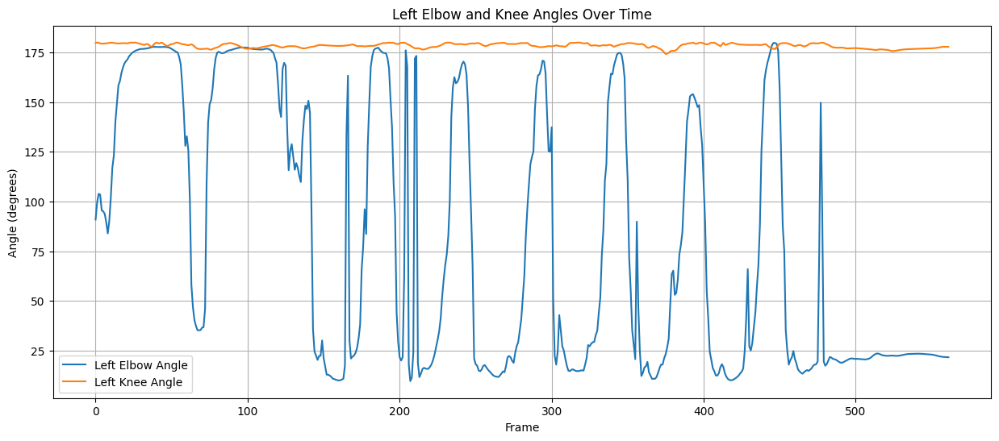

In [ ]:
import matplotlib.pyplot as plt

plt.figure(figsize=(15, 6))
plt.plot(posture_df['frame'], posture_df['left_elbow_angle'], label='Left Elbow Angle')
plt.plot(posture_df['frame'], posture_df['left_knee_angle'], label='Left Knee Angle')
plt.xlabel('Frame')
plt.ylabel('Angle (degrees)')
plt.title('Left Elbow and Knee Angles Over Time')
plt.legend()
plt.grid(True)
plt.show()

Analyze Feedback Frequency

In [ ]:
from collections import Counter

all_feedback_messages = []
for feedback_text in posture_df['feedback']:
    all_feedback_messages.extend([msg.strip() for msg in feedback_text.split('. ') if msg.strip()])

feedback_counts = Counter(all_feedback_messages)

print("Top 10 Feedback Messages:")
for msg, count in feedback_counts.most_common(10):
    print(f"- {msg}: {count} occurrences")

Top 10 Feedback Messages:
- Left knee is too straight or not bent enough.: 559 occurrences
- Left arm is heavily bent: 308 occurrences
- Straighten your arm!: 308 occurrences
- Left arm is straight.: 138 occurrences
- Left arm is bent: 116 occurrences
- Consider straightening.: 116 occurrences
- Left knee is slightly bent, good position.: 3 occurrences


## Summary:

### Data Analysis Key Findings

*   **Setup and Data Collection:** All necessary libraries (`mediapipe`, `opencv-python`, `numpy`) were successfully installed, and the MediaPipe Pose model was initialized. A single, standardized method was used to upload the input video (`Screen Recording 2025-12-10 224759 (8).mp4`).
*   **Pose Data Extraction:** Pose landmarks were successfully extracted from all 562 frames of the input video. The extracted data, including x, y coordinates and visibility for 33 landmarks per frame, was stored in a NumPy array of shape (562, 33, 3).
*   **Data Smoothing:** A moving average filter was applied to the x and y coordinates of the extracted pose landmarks, effectively smoothing the data and reducing noise for more stable analysis.
*   **Posture Analysis:**
    *   A `calculate_angle` function was implemented to compute angles between three 2D points, specifically used for the left elbow and left knee.
    *   Per-frame angles for the left elbow and left knee were calculated based on the smoothed pose data.
    *   Textual feedback was generated for each frame, evaluating the posture of the left arm and left knee based on predefined angle thresholds (e.g., "Left arm is heavily bent. Straighten your arm!", "Left arm is straight.", "Left knee is too bent. Straighten slightly!").
    *   All analysis results, including frame index, calculated angles, and textual feedback, were compiled into a Pandas DataFrame (`posture_df`) with 562 entries.
*   **Annotated Video Output:** An output video (`output_posture_analysis.mp4`) was successfully generated at 30.0 frames per second. This video visually displays the MediaPipe pose landmarks and overlays the real-time textual posture feedback for each frame, and was then displayed.

### Insights or Next Steps

*   The current analysis provides frame-by-frame textual feedback on specific joint angles, which is valuable for identifying momentary posture issues. Expanding the analysis to track posture over time (e.g., average angle, duration in incorrect posture) could provide more comprehensive insights into overall performance.
*   To enhance user experience, the system could be extended to analyze additional body parts (e.g., right arm, torso) and provide more detailed and holistic feedback for various exercises. Incorporating a graphical representation of the angles on the output video, alongside the textual feedback, would provide quantitative visual cues.


Categorize Posture Status and Visualize Over Time

In [ ]:

def get_elbow_posture_status(feedback):
    if 'Left arm is straight.' in feedback:
        return 'Good'
    elif 'Left arm is heavily bent.' in feedback or 'Left arm is bent.' in feedback:
        return 'Bad'
    return 'Unknown'

def get_knee_posture_status(feedback):
    if 'Left knee is slightly bent, good position.' in feedback:
        return 'Good'
    elif 'Left knee is too straight or not bent enough.' in feedback or 'Left knee is too bent.' in feedback:
        return 'Bad'
    return 'Unknown'

posture_df['elbow_posture_status'] = posture_df['feedback'].apply(get_elbow_posture_status)
posture_df['knee_posture_status'] = posture_df['feedback'].apply(get_knee_posture_status)

print("Posture statuses categorized and added to DataFrame:")
display(posture_df[['frame', 'elbow_posture_status', 'knee_posture_status']].head())


Posture statuses categorized and added to DataFrame:


,frame,elbow_posture_status,knee_posture_status
0,0,Bad,Bad
1,1,Bad,Bad
2,2,Bad,Bad
3,3,Bad,Bad
4,4,Bad,Bad


from matplotlib import pyplot as plt
_df_12['index'].plot(kind='hist', bins=20, title='index')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_13['frame'].plot(kind='hist', bins=20, title='frame')
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
_df_14.plot(kind='scatter', x='index', y='frame', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['index']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'index'}, axis=1)
              .sort_values('index', ascending=True))
  xs = counted['index']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_15.sort_values('index', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('index')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
import seaborn as sns
def _plot_series(series, series_name, series_index=0):
  palette = list(sns.palettes.mpl_palette('Dark2'))
  counted = (series['frame']
                .value_counts()
              .reset_index(name='counts')
              .rename({'index': 'frame'}, axis=1)
              .sort_values('frame', ascending=True))
  xs = counted['frame']
  ys = counted['counts']
  plt.plot(xs, ys, label=series_name, color=palette[series_index % len(palette)])

fig, ax = plt.subplots(figsize=(10, 5.2), layout='constrained')
df_sorted = _df_16.sort_values('frame', ascending=True)
_plot_series(df_sorted, '')
sns.despine(fig=fig, ax=ax)
plt.xlabel('frame')
_ = plt.ylabel('count()')

from matplotlib import pyplot as plt
_df_17['index'].plot(kind='line', figsize=(8, 4), title='index')
plt.gca().spines[['top', 'right']].set_visible(False)

from matplotlib import pyplot as plt
_df_18['frame'].plot(kind='line', figsize=(8, 4), title='frame')
plt.gca().spines[['top', 'right']].set_visible(False)

*Visualize Elbow and Knee Angles with Posture Status Over Time*

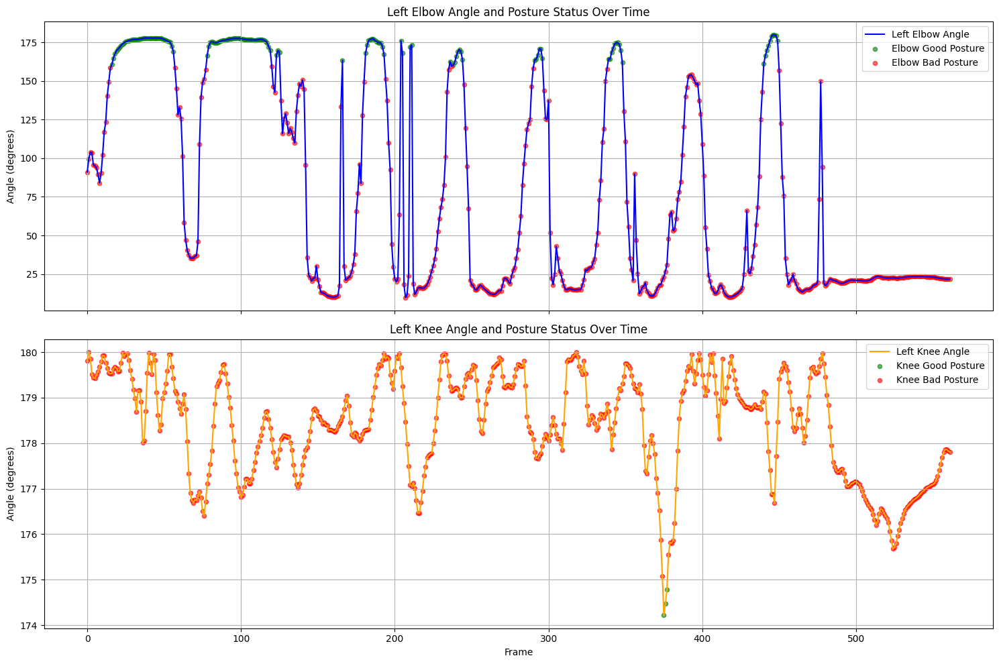

In [ ]:
import matplotlib.pyplot as plt

fig, axes = plt.subplots(2, 1, figsize=(15, 10), sharex=True)

sns.lineplot(x='frame', y='left_elbow_angle', data=posture_df, ax=axes[0], color='blue', label='Left Elbow Angle')
for status in ['Good', 'Bad']:
    subset = posture_df[posture_df['elbow_posture_status'] == status]
    if not subset.empty:
        color = 'green' if status == 'Good' else 'red'
        axes[0].scatter(subset['frame'], subset['left_elbow_angle'], color=color, s=20, label=f'Elbow {status} Posture', alpha=0.6)
axes[0].set_title('Left Elbow Angle and Posture Status Over Time')
axes[0].set_ylabel('Angle (degrees)')
axes[0].legend()
axes[0].grid(True)

sns.lineplot(x='frame', y='left_knee_angle', data=posture_df, ax=axes[1], color='orange', label='Left Knee Angle')
for status in ['Good', 'Bad']:
    subset = posture_df[posture_df['knee_posture_status'] == status]
    if not subset.empty:
        color = 'green' if status == 'Good' else 'red'
        axes[1].scatter(subset['frame'], subset['left_knee_angle'], color=color, s=20, label=f'Knee {status} Posture', alpha=0.6)
axes[1].set_title('Left Knee Angle and Posture Status Over Time')
axes[1].set_xlabel('Frame')
axes[1].set_ylabel('Angle (degrees)')
axes[1].legend()
axes[1].grid(True)

plt.tight_layout()
plt.show()


*Feedback Messages for 'Good' Knee Posture*

In [ ]:
good_knee_posture_feedback = posture_df[posture_df['knee_posture_status'] == 'Good']
display(good_knee_posture_feedback[['frame', 'feedback']])

,frame,feedback
375,375,Left arm is heavily bent. Straighten your arm!...
376,376,Left arm is heavily bent. Straighten your arm!...
377,377,Left arm is heavily bent. Straighten your arm!...


Visualize Reference Posture (Frame 375)

Displaying reference posture from frame 375 (Good Knee Posture):


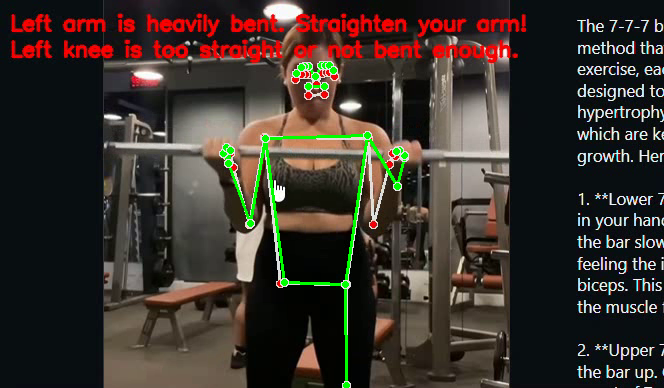

In [ ]:
cap_ref = cv2.VideoCapture(input_video_path)

reference_frame_idx = 375
cap_ref.set(cv2.CAP_PROP_POS_FRAMES, reference_frame_idx)

success, frame_ref = cap_ref.read()

if success:
    rgb_frame_ref = cv2.cvtColor(frame_ref, cv2.COLOR_BGR2RGB)
    results_ref = pose.process(rgb_frame_ref)

    if results_ref.pose_landmarks:
        mp_drawing.draw_landmarks(frame_ref,
                                  results_ref.pose_landmarks,
                                  mp_pose.POSE_CONNECTIONS,
                                  mp_drawing.DrawingSpec(color=(0, 255, 0), thickness=2, circle_radius=2),
                                  mp_drawing.DrawingSpec(color=(0, 255, 0), thickness=2, circle_radius=2))
        print(f"Displaying reference posture from frame {reference_frame_idx} (Good Knee Posture):")
        cv2_imshow(frame_ref)
    else:
        print(f"No pose landmarks detected for reference frame {reference_frame_idx}.")
else:
    print(f"Could not read reference frame {reference_frame_idx}.")

cap_ref.release()


In [ ]:
cap = cv2.VideoCapture(input_video_path)

original_fps = cap.get(cv2.CAP_PROP_FPS)
frame_width = int(cap.get(cv2.CAP_PROP_FRAME_WIDTH))
frame_height = int(cap.get(cv2.CAP_PROP_FRAME_HEIGHT))

enhanced_output_video_path = 'enhanced_output_posture_analysis.mp4'
fourcc = cv2.VideoWriter_fourcc(*'mp4v')
out_enhanced = cv2.VideoWriter(enhanced_output_video_path, fourcc, original_fps, (frame_width, frame_height))

print(f"Generating enhanced annotated video: {enhanced_output_video_path}")

DEFAULT_LANDMARK_COLOR = (0, 255, 0)
DEFAULT_CONNECTION_COLOR = (0, 255, 0)
GREEN = (0, 255, 0)
RED = (0, 0, 255)

frame_count = 0
while cap.isOpened():
    success, frame = cap.read()
    if not success:
        break

    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    results = pose.process(rgb_frame)

    if frame_count < len(posture_df):
        current_frame_data = posture_df.iloc[frame_count]
        current_feedback = current_frame_data['feedback']
        elbow_status = current_frame_data['elbow_posture_status']
        knee_status = current_frame_data['knee_posture_status']
    else:
        current_feedback = "No feedback"
        elbow_status = "Unknown"
        knee_status = "Unknown"

    elbow_segment_color = GREEN if elbow_status == 'Good' else RED
    knee_segment_color = GREEN if knee_status == 'Good' else RED

    lm_specs_dict = {}
    conn_specs_dict = {}

    for lm_enum_value in range(len(mp_pose.PoseLandmark)):
        lm_specs_dict[lm_enum_value] = mp_drawing.DrawingSpec(color=DEFAULT_LANDMARK_COLOR, thickness=2, circle_radius=2)

    for connection_tuple in mp_pose.POSE_CONNECTIONS:
        conn_specs_dict[connection_tuple] = mp_drawing.DrawingSpec(color=DEFAULT_CONNECTION_COLOR, thickness=2)

    lm_specs_dict[LEFT_SHOULDER] = mp_drawing.DrawingSpec(color=elbow_segment_color, thickness=2, circle_radius=2)
    lm_specs_dict[LEFT_ELBOW] = mp_drawing.DrawingSpec(color=elbow_segment_color, thickness=2, circle_radius=2)
    lm_specs_dict[LEFT_WRIST] = mp_drawing.DrawingSpec(color=elbow_segment_color, thickness=2, circle_radius=2)
    conn_specs_dict[(LEFT_SHOULDER, LEFT_ELBOW)] = mp_drawing.DrawingSpec(color=elbow_segment_color, thickness=2)
    conn_specs_dict[(LEFT_ELBOW, LEFT_WRIST)] = mp_drawing.DrawingSpec(color=elbow_segment_color, thickness=2)

    lm_specs_dict[LEFT_HIP] = mp_drawing.DrawingSpec(color=knee_segment_color, thickness=2, circle_radius=2)
    lm_specs_dict[LEFT_KNEE] = mp_drawing.DrawingSpec(color=knee_segment_color, thickness=2, circle_radius=2)
    lm_specs_dict[LEFT_ANKLE] = mp_drawing.DrawingSpec(color=knee_segment_color, thickness=2, circle_radius=2)
    conn_specs_dict[(LEFT_HIP, LEFT_KNEE)] = mp_drawing.DrawingSpec(color=knee_segment_color, thickness=2)
    conn_specs_dict[(LEFT_KNEE, LEFT_ANKLE)] = mp_drawing.DrawingSpec(color=knee_segment_color, thickness=2)


    if results.pose_landmarks:
        mp_drawing.draw_landmarks(frame,
                                  results.pose_landmarks,
                                  mp_pose.POSE_CONNECTIONS,
                                  landmark_drawing_spec=lm_specs_dict,
                                  connection_drawing_spec=conn_specs_dict)

    font = cv2.FONT_HERSHEY_SIMPLEX
    font_scale = 0.7
    font_thickness = 2
    feedback_text_color = (255, 255, 255)
    text_x = 10
    text_y = 30
    for i, msg in enumerate(current_feedback.split('. ')):
        if msg:
            cv2.putText(frame, msg, (text_x, text_y + i * 30), font, font_scale, feedback_text_color, font_thickness, cv2.LINE_AA)

    out_enhanced.write(frame)
    frame_count += 1

cap.release()
out_enhanced.release()

print(f"Enhanced annotated video generated successfully at {enhanced_output_video_path}.")

Generating enhanced annotated video: enhanced_output_posture_analysis.mp4
Enhanced annotated video generated successfully at enhanced_output_posture_analysis.mp4.


In [ ]:
from IPython.display import Video

print(f"Displaying enhanced output video: {enhanced_output_video_path}")
Video(enhanced_output_video_path, embed=True)

Displaying enhanced output video: enhanced_output_posture_analysis.mp4


### Remove Redundant `!pip install` Cells

To finalize the consolidation, please delete the following cells, as their content has been moved to the new consolidated installation cell:

*   `hqqFSdmQH7FT`
*   `gNkH1s9VLWJc`
*   `dutHzbAtOV-G`
*   `514b7886`